Author: Tyler Chase

Date: 04/08/2018

# Coding Challenge 1

## Part 1: Parse the DICOM Images and Contour Files

In [1]:
# Parse all DICOM Images and Contour Files Pipe to Numpy Arrays

# Suppress warning due to old version of pydicom
import warnings
warnings.filterwarnings('ignore')

from parsing import Pipe

dataAddress = '/Users/tylerchase/Documents/professional/job_applications_2018/' + \
              'Arterys/challenges/challengePhase1/data/final_data'
output = Pipe(dataAddress)

In [2]:
# Some unit tests of the contour parsing 
import numpy as np

print(('Count', 'Height', 'Width'))
print('DCM Array Shape:', np.shape(output.dcmArray))
print('Contour Array Shape:', np.shape(output.contourArray))
print('Label Array Shape:', np.shape(output.labels))

print('\nContour Max:', int(np.amax(output.contourArray)))
print('Contour Min:', int(np.amin(output.contourArray)))

('Count', 'Height', 'Width')
DCM Array Shape: (96, 256, 256)
Contour Array Shape: (96, 256, 256)
Label Array Shape: (96,)

Contour Max: 1
Contour Min: 0


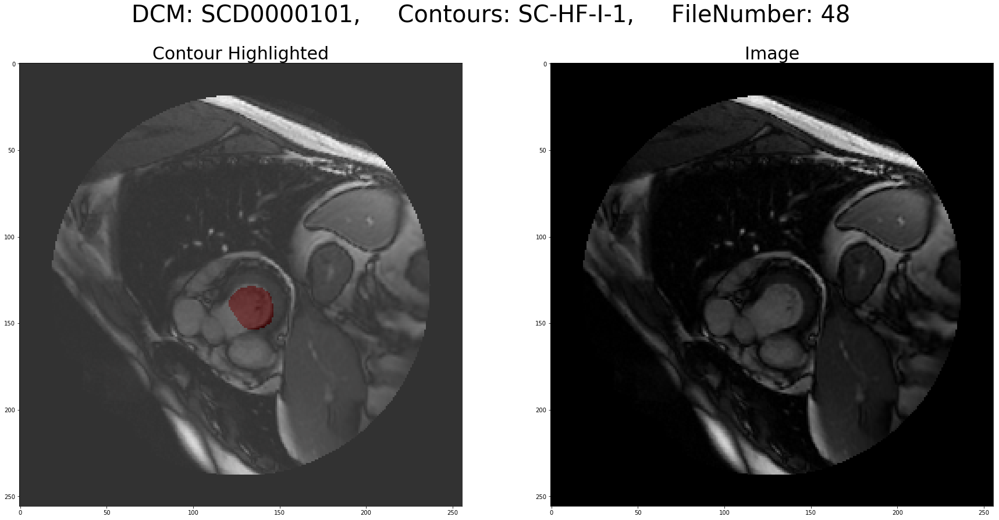

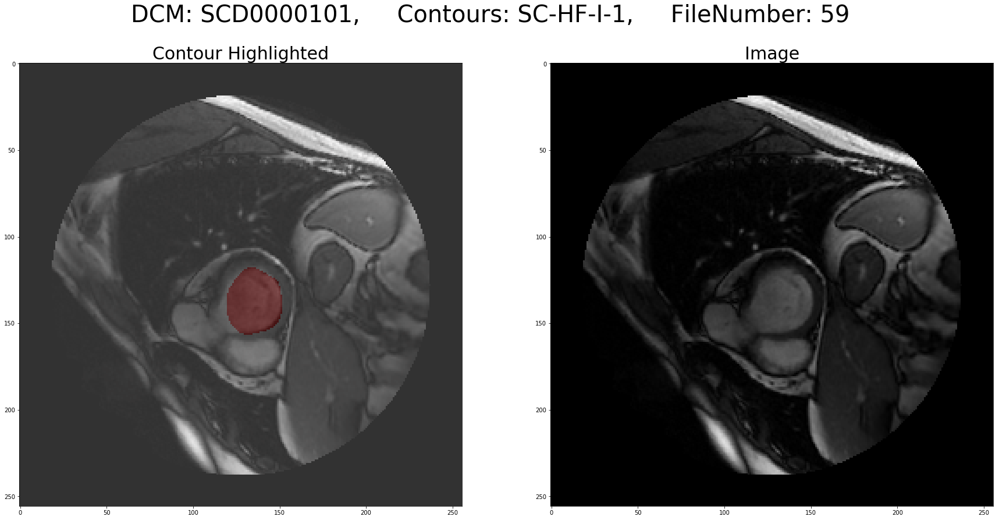

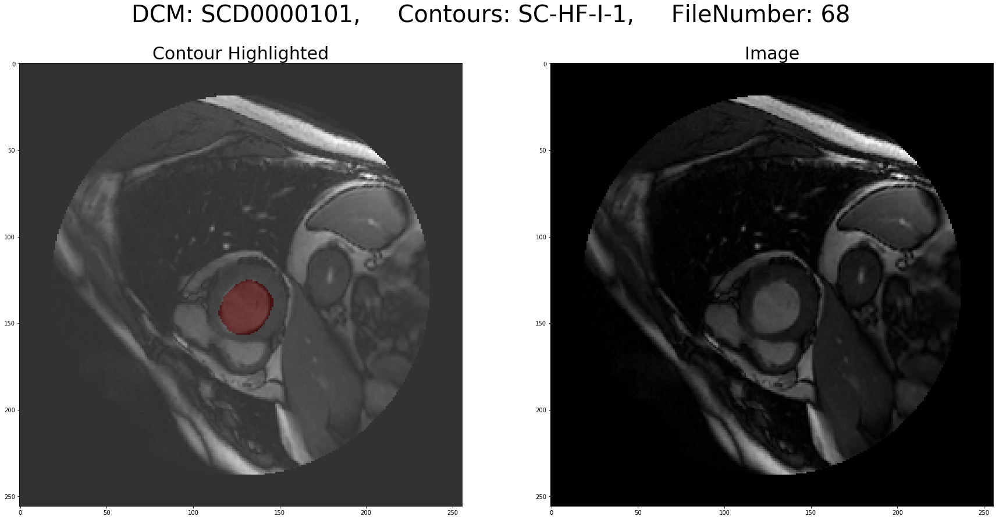

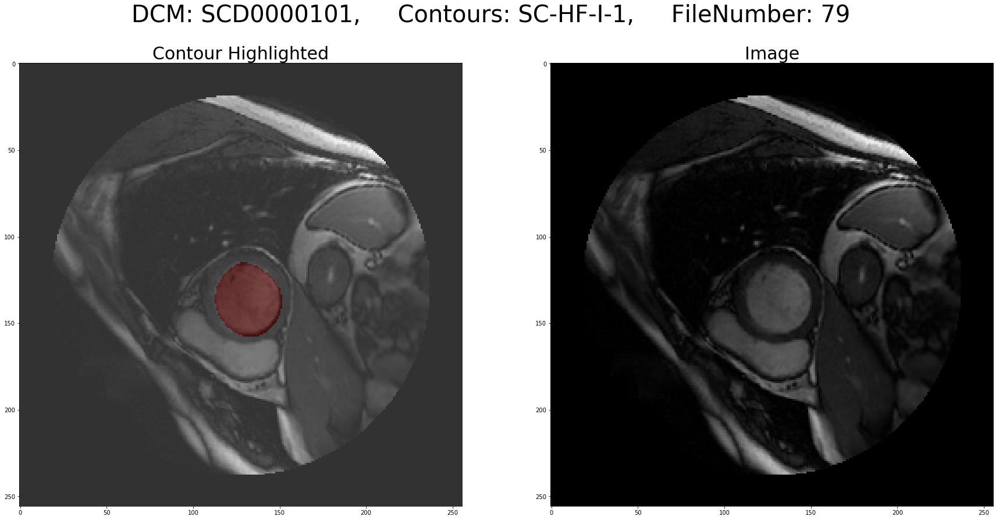

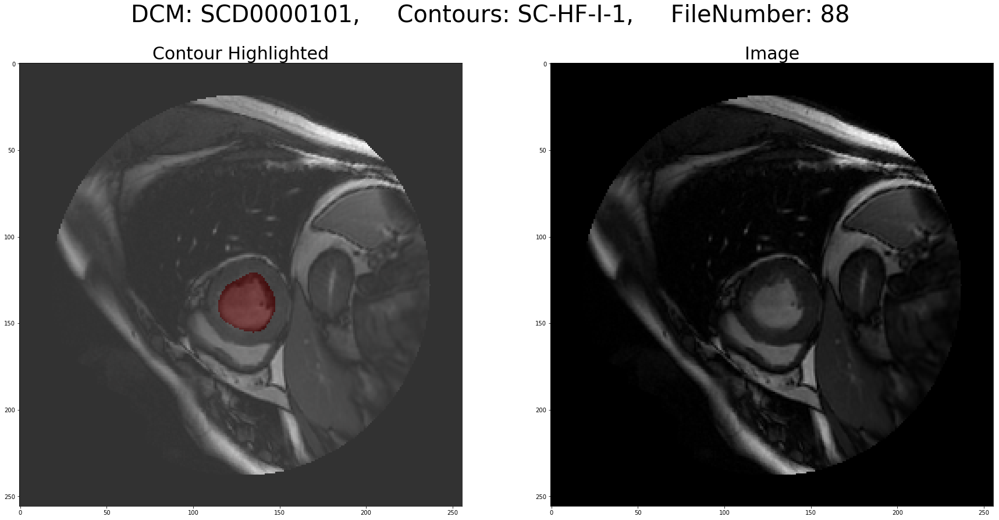

...

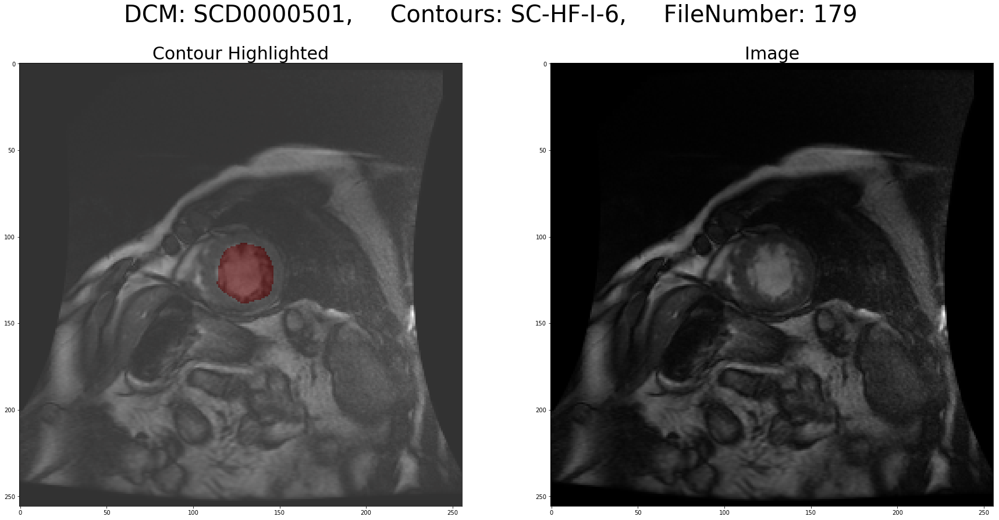

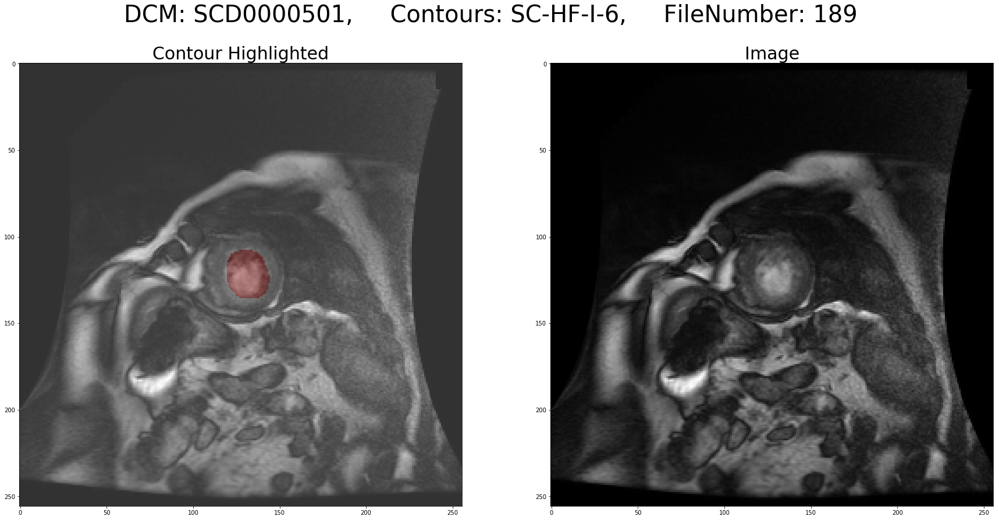

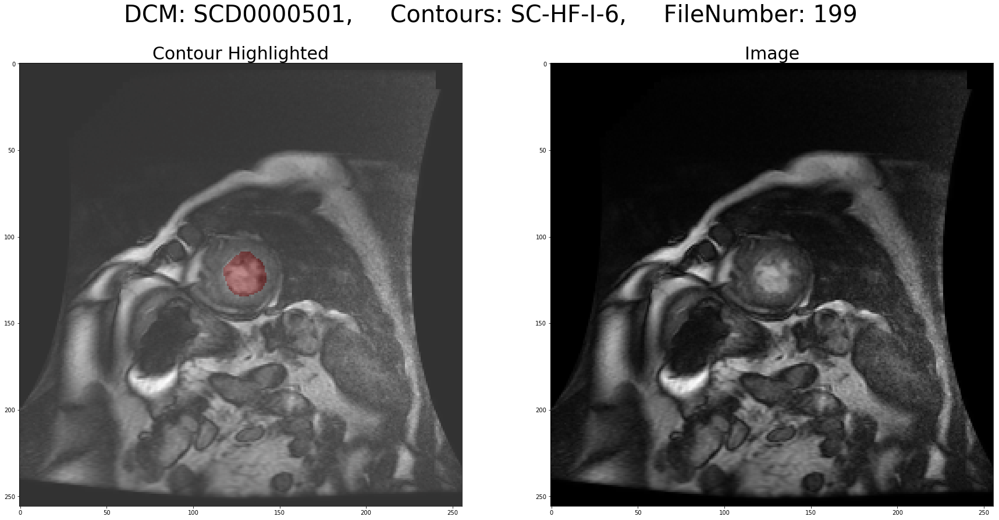

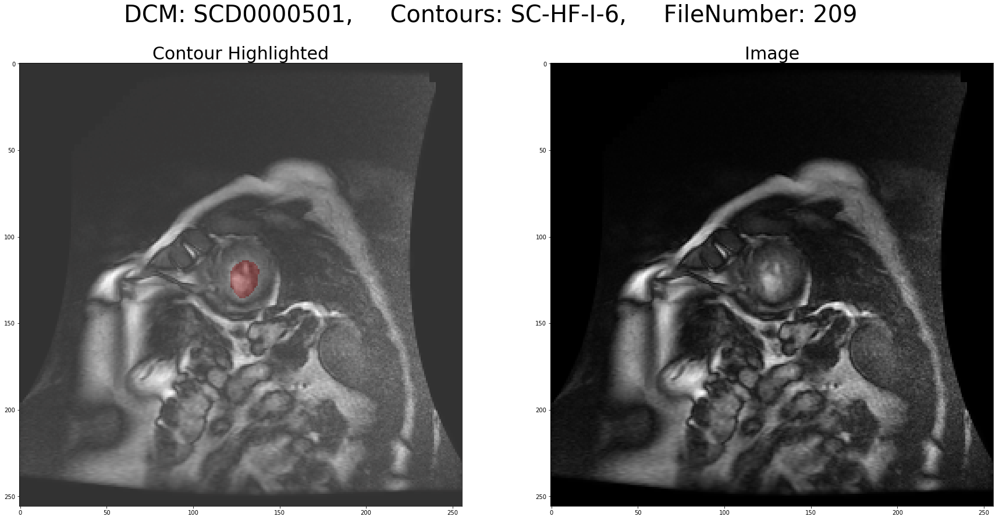

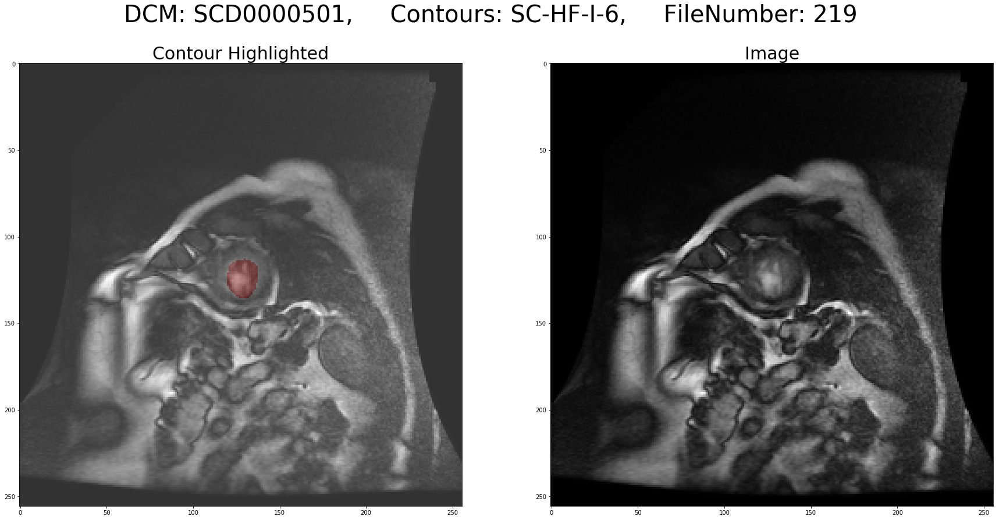

In [3]:
# Plot contours over DICOM images as a sanity check (unit test)
output.plotPipedData()

### Part 1 Questions

#### How did you verify that you are parsing the contours correctly?
I verified that I was parsing the contours correctly by a series of unit tests. We see that the dimensions of the contours match the dimensions of the DICOM images. The total number of DICOM images that have contour labels is 96 which matches the total sample count of the contour array. The maximum of the contour masks is 1 and the minimum of the contour mask is 0. Every Contour was then plotted on top of the DICOM image as a sanity check (another unit test). I am not a domain expert but the results seam consistent with highlighting the myocardium in MRI images. Certainly the shape of the bulb of contrast seems properly highlighted for each image. 

#### What changes did you make to the code, if any, in order to integrate it into our production code base?
I wrapped the starter code in a class named Pipe and added 5 additional methods. The method named processDcmContour() processes the dcm file and contour file, returnign a DICOM image and binary mask of the contour. The method named plotDcmContour() plots the DICOM image and it's respective contour for visualization. The method named plotPipedData() plots all scan image cross-sections with their respective contours (ordered by index id and numerical value of file). The method determineContourNumbers() returns an array of contour file numbers from a folder of contours. This method is necessary in order to know which DCM files we have contours for. Lastly, the method pipeToNumpy() processes all DCMs and contours to numpy arrays (ordered by index id and numerical value of file). 

## Part 2: Model training pipeline

In [4]:
# Permute the data and sample in batches 
#(note batch statistics are output instead of feeding into neural network)
from parsing import batchify

batchify(output.dcmArray, output.contourArray, output.labels, 
         batch_size = 8, epochs = 2)

epoch: 1
batch: 1
X_batch shape: (8, 256, 256)
y_batch shape: (8, 256, 256)
DCM: SCD0000501,     Contours: SC-HF-I-6,     FileNumber: 219
DCM: SCD0000301,     Contours: SC-HF-I-4,     FileNumber: 167
DCM: SCD0000501,     Contours: SC-HF-I-6,     FileNumber: 139
DCM: SCD0000301,     Contours: SC-HF-I-4,     FileNumber: 120
DCM: SCD0000201,     Contours: SC-HF-I-2,     FileNumber: 180
DCM: SCD0000401,     Contours: SC-HF-I-5,     FileNumber: 67
DCM: SCD0000301,     Contours: SC-HF-I-4,     FileNumber: 67
DCM: SCD0000101,     Contours: SC-HF-I-1,     FileNumber: 48

epoch: 1
batch: 2
X_batch shape: (8, 256, 256)
y_batch shape: (8, 256, 256)
DCM: SCD0000301,     Contours: SC-HF-I-4,     FileNumber: 80
DCM: SCD0000401,     Contours: SC-HF-I-5,     FileNumber: 120
DCM: SCD0000201,     Contours: SC-HF-I-2,     FileNumber: 207
DCM: SCD0000201,     Contours: SC-HF-I-2,     FileNumber: 200
DCM: SCD0000301,     Contours: SC-HF-I-4,     FileNumber: 200
DCM: SCD0000401,     Contours: SC-HF-I-5,    

### Part 2 Questions

#### Did you change anything from the pipelines built in parts 1 to better streamline the pipeline for part 2? If so what? If not, is there anything that you can imagine changing in the future?

I did not change anything significantly from part 1 to better streamline part 2. In fact one of the reasons my output of part 1 is a combined numpy array is because I was looking ahead to part 2. In the future it would likely be a good idea to read the dataset in batches instead of reading the entire thing into RAM. For a very large dataset the pipeline would likely break since the entire dataset is being read into memory. Another thing that would be good to change in the future is to parallelize the pipeline from part 1. The same sort of calculation is being done many times which lends itself to parallelization. 

#### How do you/did you verify that the pipeline was working correctly?

I verified that I was parsing the contours correctly by a series of unit tests. We see that the dimensions of the contours match the dimensions of the DICOM images. The total number of DICOM images that have contour labels is 96 which matches the total sample count of the contour array. The maximum of the contour masks is 1 and the minimum of the contour mask is 0. 

I verified that the parsing of the dicom files were correct by plotting them in grayscale. They appear like typical MRI cross sections. 

Every Contour was then plotted on top of the DICOM image as a sanity check (another unit test). The title has the origin directory of the DICOM image, the origin directory of the contour, and the file number. The directories were spot checked with the link csv and the file numbers were checked with the respective directories. I am not a domain expert but the results seam consistent with highlighting the myocardium in MRI images. Certainly the shape of the bulb of contrast seems properly highlighted for each image. 

I verified that the batch loading code worked correctly by looking at some values of each batch. The epoch number and batch number are printed and behave as expected. The input batch and outpt batch are of dimension 8 x Width x height as expected. The file origin names were then spot checked to ensure that they were permuted and that they spanned the entire dataset with no repeats. 


#### Given the pipeline you have build, can you see any deficiencies that you would change if you had more time? If not, can you think of any improvements/enhancements to the pipeline that you could build in?

There are definitely some deficiencies that I would change if I had more time like I mentioned briefly in question 1 of part 2. In the future it would likely be a good idea to read the dataset in batches instead of reading the entire thing into RAM. For a very large dataset the pipeline would likely break since the entire dataset is being read into memory. Another thing that would be good to change in the future is to parallelize the pipeline from part 1. The same sort of calculation is being done many times which lends itself to parallelization. It also may be interesting to analyze if a different permutation for each epoch leads to better convergence. 
